In [2]:
import tifffile
import numpy as np
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from ultralytics import YOLO
import pandas as pd
import torch, torchvision
from scipy.spatial import Voronoi, voronoi_plot_2d
print("torchvision: ", torchvision.__version__)
print('CUDA available:', torch.cuda.is_available())

torchvision:  0.17.2
CUDA available: True


In [6]:
base_path = r"R:\FIVE\EXP\FIV925\Additional Datasets"

# colon cancer data
dataset = "Human Colon Cancer"
ome_tiff_path = f"{base_path}\\{dataset}\\Visium_HD_Human_Colon_Cancer_tissue_image.btf"

# lung cancer data
# dataset = "Human Lung Cancer"
# ome_tiff_path = f"{base_path}\\{dataset}\\morphology_mip.ome.tif"

scale_factor = 1

# so this is a "TiffFile" type 
#   what is that?
tif = tifffile.TiffFile(ome_tiff_path)
# this is turned into this numpy array, and for some reason the lung cancer (morphology_mip.ome.tif) image is different dimensions than the colon cancer image (Visium_HD_Human_Colon_Cancer_image.tif)
#   oh, I think it's cuz the lung cancer image is b/w while the colon cancer image is color
#       so, perhaps I need to change the colon cancer image to b/w?
#       well, we should be able to segment a color image regardless
#   I think I have to get just one of the channels
#   it looks like there are 3 channels?
image = tif.asarray()
# image_data = image[::2, ::2]

# rescale to 8bit, but this doesn't actually do anything because image_data is already 8bit
# max_val_16bit = np.max(image_data)
# image_scaled = (image_data / max_val_16bit) * 255
# image_8bit = image_scaled.astype(np.uint8)

ok so the colon cancer data is an image represented as an RGB image
	- the lung cancer data is represented as an array of shape (24097, 21234)

In [7]:
image_dims = image.shape
print("tif type:", type(tif))
print("image type:", type(image))
print("shape of image:", image_dims)
print("the shape of the image is represented as a:", type(image_dims))
print("the first entry in image is:", image[0][0])
# print("are image_data and image_8bit the same? " + ("yes" if np.array_equal(image_8bit, image_data) else "no")) # could also define np.array_equal above as a bool

tif type: <class 'tifffile.tifffile.TiffFile'>
image type: <class 'numpy.ndarray'>
shape of image: (48740, 75250, 3)
the shape of the image is represented as a: <class 'tuple'>
the first entry in image is: [238 240 239]


# viewing parts of image
ok, i just need to view around the parts of the image with the colon cancer to see which channel has the best showing of nuclei
<p>use the first channel

(-0.5, 782.5, 506.5, -0.5)

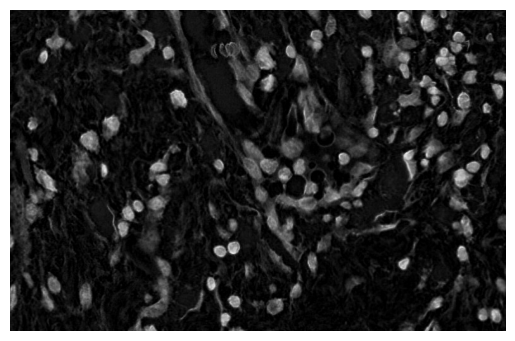

In [9]:
height, width = image.shape[:2]
mid_y = height // 2
mid_x = width // 2
# what does sca mean?
top_left_quadrant = image[:mid_y,:mid_x,0]
somewhere_in_the_middle = image[mid_y:mid_y+(height // 96),mid_x:mid_x+(width // 96),0]
inverted = 1- somewhere_in_the_middle
# sca = sca / np.quantile(image_data,0.99) # rescale the intensity, if we use max it is way to far outside
# sca[sca > 1] = 1
plt.imshow(inverted, cmap='gray')
plt.axis('off')  # to hide axis labels and ticks 

In [11]:
tile_size = 384
image_height, image_width = image_dims[0], image_dims[1]
yolo_model_path = r"S:\Phys\FIV925 XSection\Datasets\Brain\01c\YO 432 0515 Yeti\map75=0669758 yolov9c .pt idx=4 ep=8 btch=8 rnd=4229985\weights\best.pt"
model = YOLO(yolo_model_path)
df = pd.DataFrame()
image_single_channel = image[:,:,0]

list_of_centers = []

# for each tile in the image ...
# I wanna predict on the tile, and also draw voronoi boxes over it?
#   Ohh, so I need to predict on the image to find the centers of the cells, then use voronoi to draw the boundaries over the cells
for i in range(0, image_height, (height // 96)): # section_miny, section_maxy
    for j in range(0, image_width, (width // 96)): # section_minx, section_maxx
        tile = image_single_channel[i:i+(height // 96), j:j+(width // 96)]
        if tile.shape[0] == 0 or tile.shape[1] == 0:
            continue  # Skip tiles that have no width or height
        
        # what is the 'L' for?
        tile_as_img = Image.fromarray(tile, 'L')
        predictions = model.predict(tile_as_img, show=False, max_det=3000)
        
        result = predictions[0]
        
        # ok, so I can just make a list of the centers of the predictions and have the voronoi algorithm make the segmentations
        boxes_tensor = result.boxes.xywh
        boxes_array = boxes_tensor.cpu().numpy()
        centers = boxes_array[:, :2]
        
        # need to flip i and j here because the list of boxes are of form xy instead of row,col
        to_add = np.array([j,i])
        
        centers_scaled = centers + to_add
        
        # now should I create the voronoi boundaries over each tile? or should I create them all at once on the big image?
        if centers.size != 0:
            list_of_centers.append(centers_scaled)


0: 320x448 (no detections), 20.0ms
Speed: 2.0ms preprocess, 20.0ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 448)

0: 320x448 (no detections), 19.0ms
Speed: 2.0ms preprocess, 19.0ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 448)

0: 320x448 (no detections), 18.1ms
Speed: 2.0ms preprocess, 18.1ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 448)

0: 320x448 (no detections), 19.0ms
Speed: 4.0ms preprocess, 19.0ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 448)

0: 320x448 (no detections), 18.0ms
Speed: 2.0ms preprocess, 18.0ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 448)

0: 320x448 (no detections), 18.0ms
Speed: 8.0ms preprocess, 18.0ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 448)

0: 320x448 (no detections), 19.0ms
Speed: 1.5ms preprocess, 19.0ms inference, 0.0ms postprocess per image at shape (1, 3, 320, 448)

0: 320x448 (no detections), 19.0ms
Speed: 7.0ms preprocess, 19.0ms i

In [16]:
vor = Voronoi(list_of_centers)
fig, ax = plt.subplots()
voronoi_plot_2d(vor, ax=ax)
ax.invert_yaxis()
plt.show()

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (9409,) + inhomogeneous part.

In [35]:
print(list_of_centers)

[array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64), array([], shape=(0, 2), dtype=float64),

# viewing predictions on a part of the image


0: 320x448 300 1s, 27.5ms
Speed: 2.0ms preprocess, 27.5ms inference, 2.0ms postprocess per image at shape (1, 3, 320, 448)


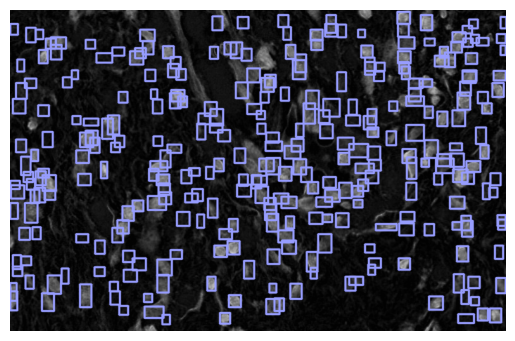

In [17]:
# first, what does predicting on this image even look like?
yolo_model_path = r"S:\Phys\FIV925 XSection\Datasets\Brain\01c\YO 432 0515 Yeti\map75=0669758 yolov9c .pt idx=4 ep=8 btch=8 rnd=4229985\weights\best.pt"
arr_as_img = Image.fromarray(inverted, 'L')
model = YOLO(yolo_model_path)
prediction = model.predict(arr_as_img, conf=0.5)
im_array = prediction[0].plot(labels=False)

plt.imshow(im_array)
plt.axis('off')
plt.show()

# im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
# im.show()  # show image

In [18]:
result = prediction[0]
boxes_xywh = result.boxes.xywh
print("result.masks.xy is a", type(boxes_xywh))
print("it looks like:")
print(boxes_xywh)
print("it's", len(boxes_xywh),"units long")

result.masks.xy is a <class 'torch.Tensor'>
it looks like:
tensor([[201.9529, 310.0820,  16.3762,  17.3410],
        [332.2113, 381.2135,  19.8680,  18.3597],
        [353.0109, 375.8960,  19.2982,  20.2370],
        ...,
        [406.7066, 119.4350,  20.4766,  21.3195],
        [141.5102, 413.7054,  16.5105,  14.4675],
        [ 16.7972,  89.1556,  11.2020,  19.4620]], device='cuda:0')
it's 300 units long


In [19]:
from scipy.spatial import Voronoi, voronoi_plot_2d

boxes_tensor = result.boxes.xywh
boxes_array = boxes_tensor.cpu().numpy()
centers = boxes_array[:, :2]
# centers_flipped = centers[:, ::-1]
vor = Voronoi(centers)

print("boxes_array:")
print(boxes_array)
print('')
print("centers:")
print(centers)


boxes_array:
[[     201.95      310.08      16.376      17.341]
 [     332.21      381.21      19.868       18.36]
 [     353.01       375.9      19.298      20.237]
 ...
 [     406.71      119.44      20.477       21.32]
 [     141.51      413.71       16.51      14.468]
 [     16.797      89.156      11.202      19.462]]

centers:
[[     201.95      310.08]
 [     332.21      381.21]
 [     353.01       375.9]
 [     746.73      481.03]
 [     731.52      248.43]
 [     52.498      75.037]
 [     527.18      235.47]
 [     501.31      329.27]
 [     46.417      40.391]
 [     483.88      41.392]
 [     549.48      306.31]
 [     766.66      482.58]
 [     354.84      460.34]
 [     573.41      194.31]
 [     477.21      398.04]
 [     563.41      66.947]
 [     317.86       432.5]
 [     622.34      75.951]
 [     753.06      156.49]
 [     415.55      247.69]
 [     682.75      173.25]
 [     770.03      127.75]
 [     548.79      287.35]
 [     575.93      400.25]
 [     762.61    

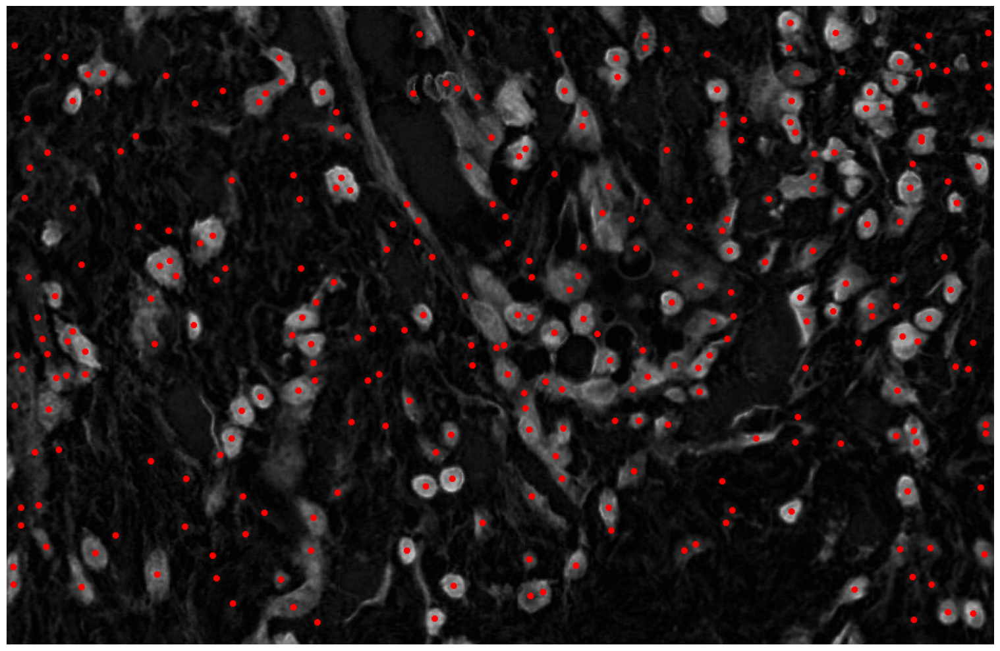

In [20]:
all_points = pd.DataFrame()
df = pd.DataFrame(boxes_array[:, :2], columns=['x', 'y'])
all_points = pd.concat([all_points, df])

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(20, 10))  
# axes = axes.ravel()
img = arr_as_img.convert('RGB')
draw = ImageDraw.Draw(img)

points = all_points[['x', 'y']].values
radius = 2
for point in points:
    x, y = point
    draw.ellipse((x - radius, y - radius, x + radius, y + radius), fill='red')
    
img_array = np.array(img)
axes.imshow(img_array)
axes.axis('off')  # Turn off axis
plt.tight_layout()
plt.show()

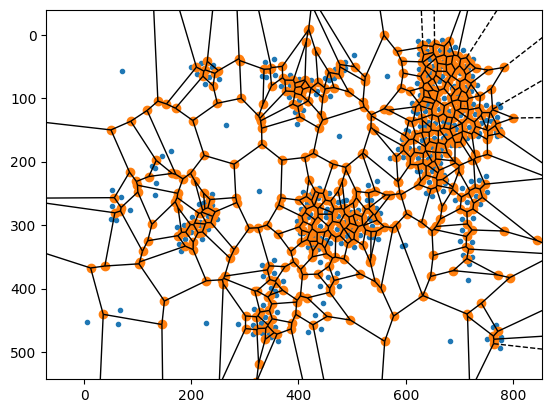

In [9]:
fig, ax = plt.subplots()
voronoi_plot_2d(vor, ax=ax)
ax.invert_yaxis()
plt.show()